In [8]:
import tensorflow as tf


In [9]:
model = tf.keras.models.load_model('img.h5')


model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 127, 127, 16)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 62, 62, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 16)        4624      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 30, 30, 16)        0

In [16]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

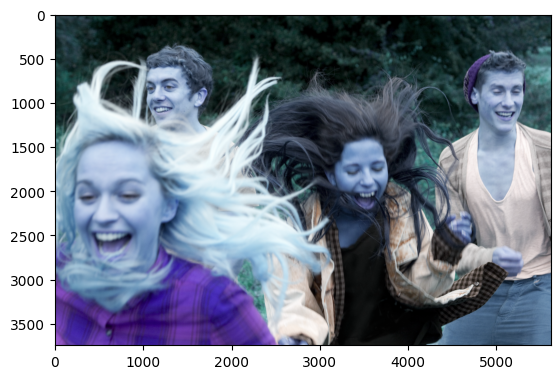

In [13]:
img = cv2.imread('154006829.jpg')
plt.imshow(img)
plt.show()

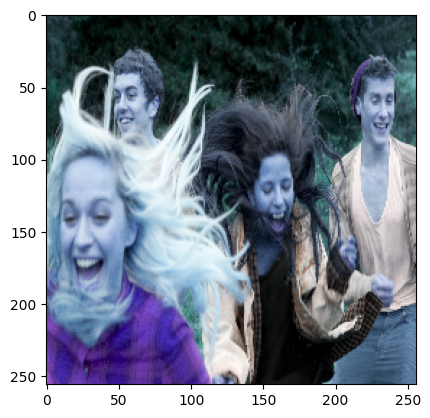

In [14]:
resize = tf.image.resize(img, (256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [17]:
yhat = model.predict(np.expand_dims(resize/255, 0))


1/1 [==============================] - 0s 363ms/step


In [18]:
def get_submodel(model, layer_name):
  return tf.keras.models.Model(
      model.input,
      model.get_layer(layer_name).output
  )

In [30]:
def create_image():
  return tf.random.uniform((256, 256, 3), minval = -0.5, maxval = 0.5)

#plots the image
def plot_image(image, title = 'random'):
  image = image - tf.math.reduce_min(image)
  image = image / tf.math.reduce_max(image)
  plt.imshow(image, cmap='gray')
  plt.xticks([])
  plt.yticks([])
  plt.title(title)
  plt.show()

#gradient ascent for maximising the given filter's output
def visualise_filters(model, layer_name, f_index = None, iters = 20):
  submodel = get_submodel(model, layer_name)
  num_filters = submodel.output.shape[-1]

  if f_index is None:
    f_index = random.randint(0, num_filters - 1)

  assert num_filters > f_index, 'filter index out of bounds'

  image = create_image()
  verbose_step = int(iters / 5)

  for i in range(0, iters):
    with tf.GradientTape() as tape:
      tape.watch(image)
      out = submodel(tf.expand_dims(image, axis = 0))[:, :, :, f_index]
      loss = tf.math.reduce_mean(out)
    grads = tape.gradient(loss, image)
    grads = tf.math.l2_normalize(grads)
    image += grads * 10


  if (i + 1) % verbose_step == 0:
      print(f'Iteration: {i + 1}, Loss: {loss.numpy():.4f}')

  plot_image(image, f'{layer_name}, {f_index}')

In [26]:
weights_FC = model.layers[-1].get_weights()[0]


#getting the output of the last convolutional layer
model_penultimate = get_submodel(model, model.layers[-5].name)


print("layer name: ", model.layers[-5].name)
#obtain the output of the last convolutional layer
activations_penultimate = model_penultimate.predict(np.expand_dims(resize/255, 0), verbose = 0)

# print(list(zip(list(range(len(activations_penultimate[0]))), activations_penultimate[0])))

layer name:  conv2d_2


In [27]:
threshold = -10

#obtaining the dot product of the weights and the activations
dot_product = np.multiply(weights_FC[0], activations_penultimate[0])

print(dot_product)
#store the indices of the filters that are bright
indices = np.where(dot_product > threshold)[0]

print(indices)

[[[1.74587753e-04 2.94837123e-03 0.00000000e+00 ... 0.00000000e+00
   9.93229041e-05 1.60448859e-03]
  [2.28385231e-03 4.05050162e-03 2.46741722e-04 ... 0.00000000e+00
   0.00000000e+00 1.61858054e-03]
  [3.74891073e-03 3.54886265e-03 2.03510441e-04 ... 0.00000000e+00
   5.91221265e-03 1.74390234e-03]
  ...
  [4.05534636e-03 4.71467758e-03 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 3.59800714e-03]
  [2.90952274e-03 4.61498601e-03 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 2.03704159e-03]
  [2.58422666e-03 3.91713949e-03 0.00000000e+00 ... 0.00000000e+00
   0.00000000e+00 1.63672003e-03]]

 [[1.10337569e-03 3.60484072e-03 0.00000000e+00 ... 0.00000000e+00
   2.25514197e-03 2.47702561e-03]
  [1.66645914e-03 1.35852816e-03 3.37073980e-05 ... 0.00000000e+00
   8.65782553e-04 2.08260282e-03]
  [5.51905995e-03 3.10641876e-03 1.47266476e-03 ... 0.00000000e+00
   7.48299528e-04 1.69727800e-03]
  ...
  [3.36566451e-03 5.16317366e-03 0.00000000e+00 ... 0.00000000e+00
   0.00000

Iteration: 20, Loss: 2.0075


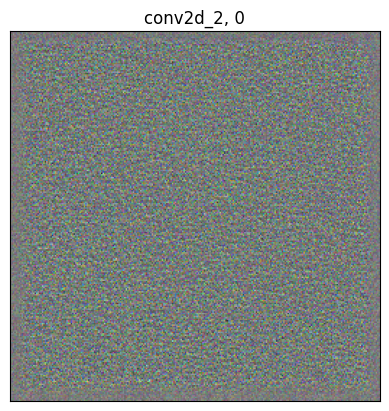

Iteration: 20, Loss: 2.0087


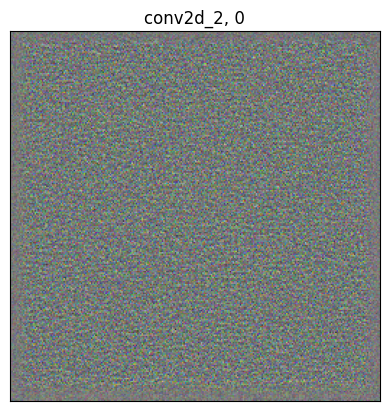

Iteration: 20, Loss: 2.0095


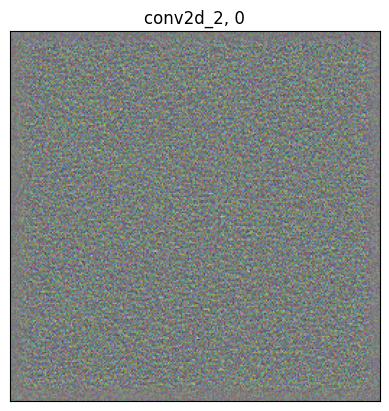

Iteration: 20, Loss: 2.0075


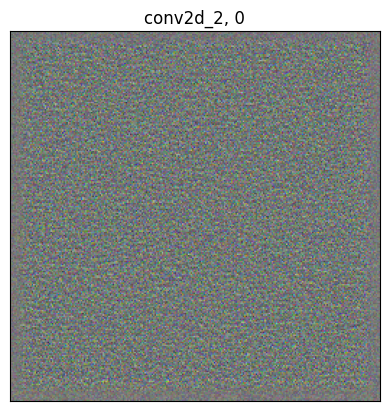

Iteration: 20, Loss: 2.0085


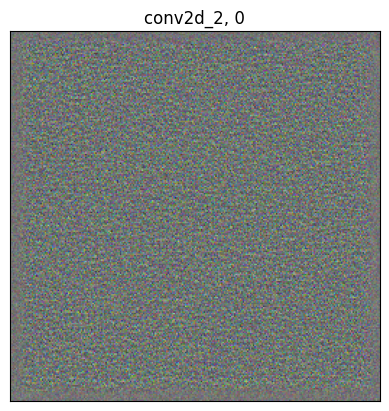

Iteration: 20, Loss: 2.0053


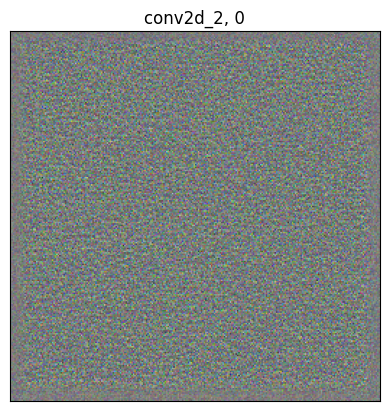

Iteration: 20, Loss: 2.0104


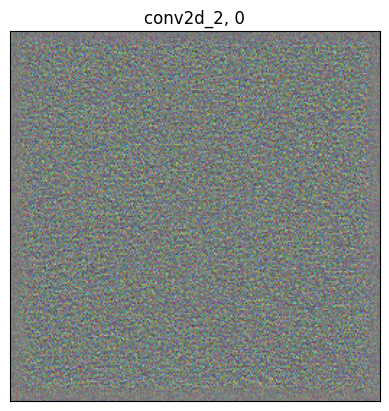

Iteration: 20, Loss: 2.0127


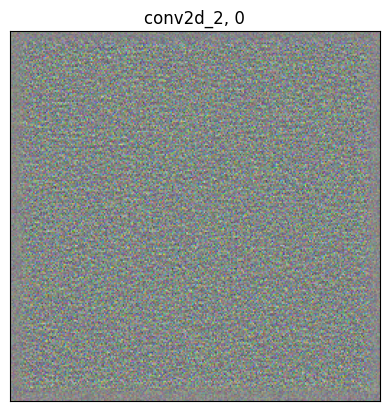

Iteration: 20, Loss: 2.0050


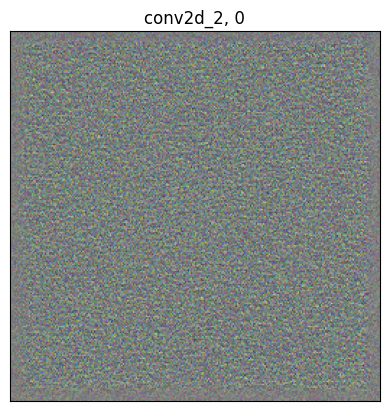

Iteration: 20, Loss: 2.0090


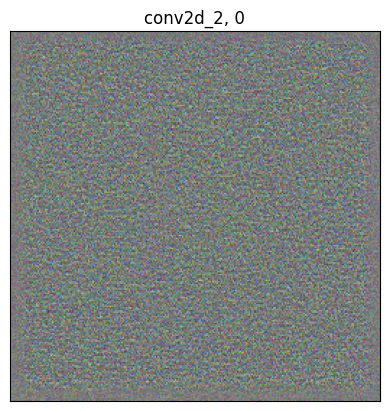

Iteration: 20, Loss: 2.0111


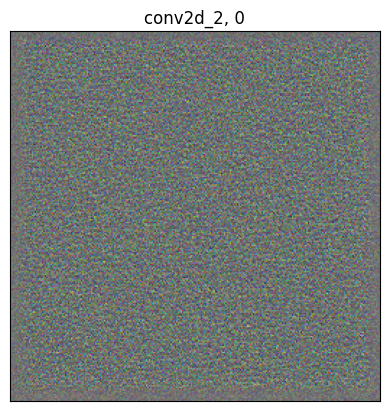

Iteration: 20, Loss: 2.0067


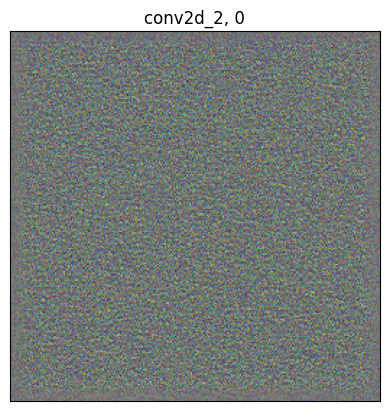

Iteration: 20, Loss: 2.0089


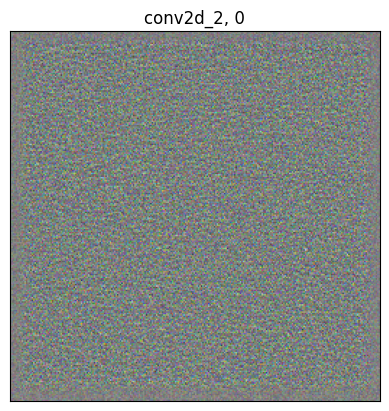

Iteration: 20, Loss: 2.0059


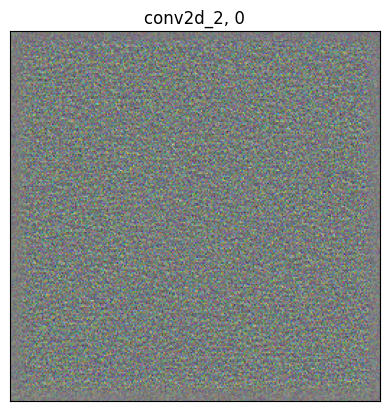

Iteration: 20, Loss: 2.0020


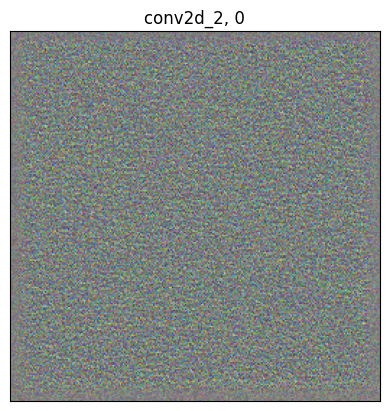

Iteration: 20, Loss: 2.0087


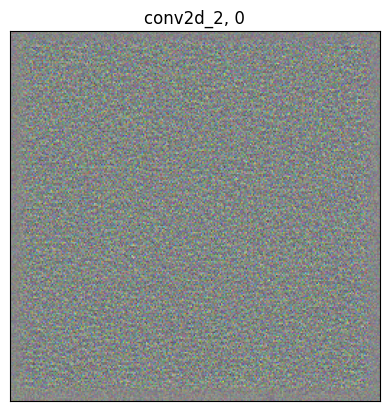

Iteration: 20, Loss: 2.0106


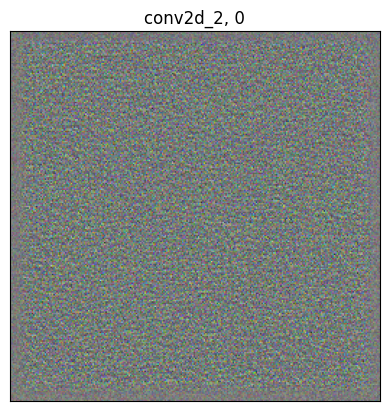

Iteration: 20, Loss: 1.9995


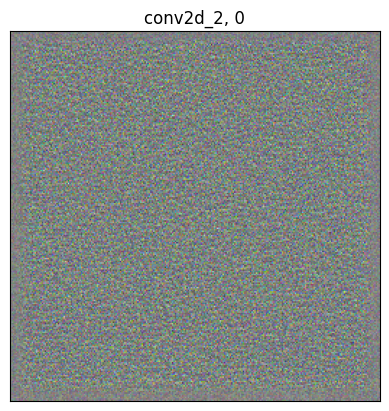

Iteration: 20, Loss: 2.0038


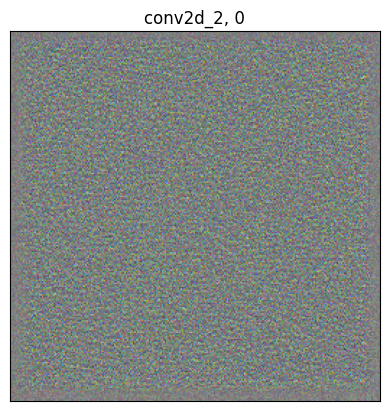

Iteration: 20, Loss: 2.0085


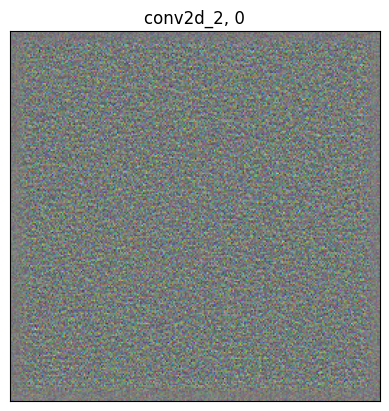

Iteration: 20, Loss: 2.0045


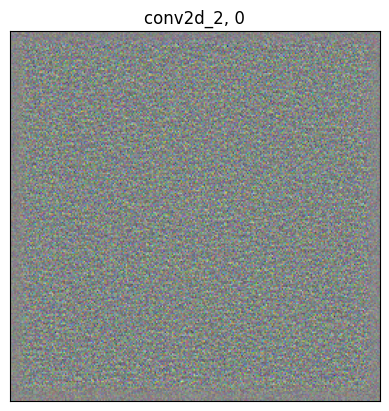

Iteration: 20, Loss: 2.0055


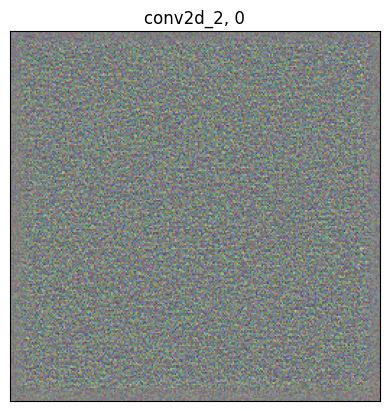

Iteration: 20, Loss: 2.0111


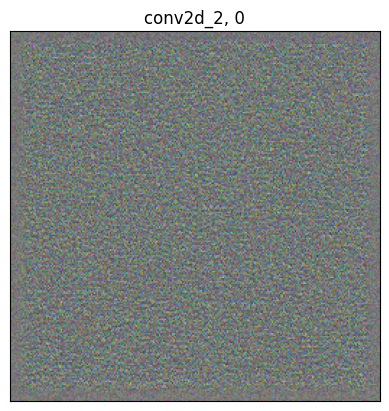

Iteration: 20, Loss: 2.0075


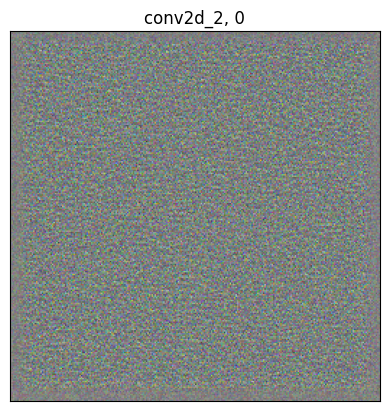

Iteration: 20, Loss: 2.0051


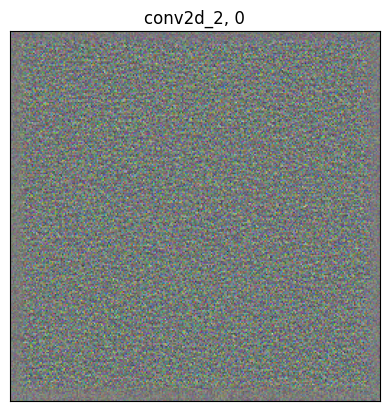

Iteration: 20, Loss: 2.0103


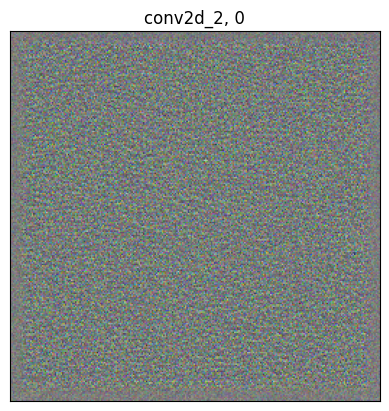

Iteration: 20, Loss: 2.0038


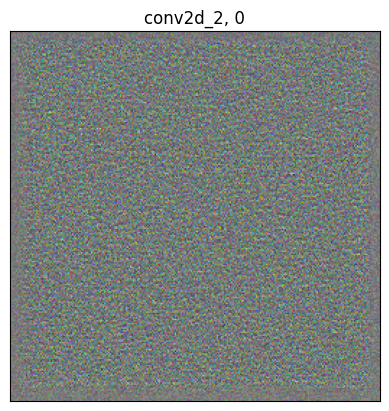

Iteration: 20, Loss: 2.0109


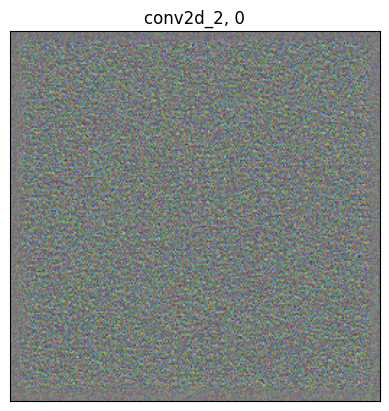

Iteration: 20, Loss: 2.0057


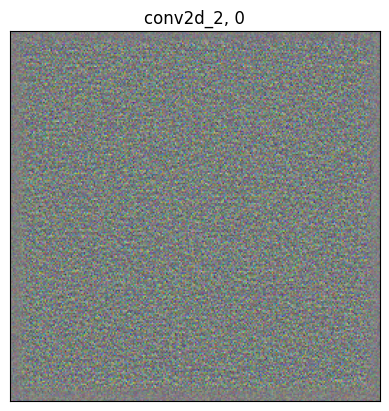

Iteration: 20, Loss: 2.0067


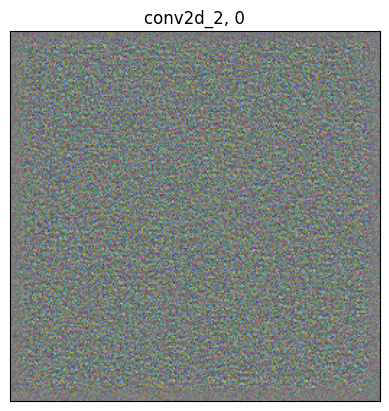

Iteration: 20, Loss: 2.0097


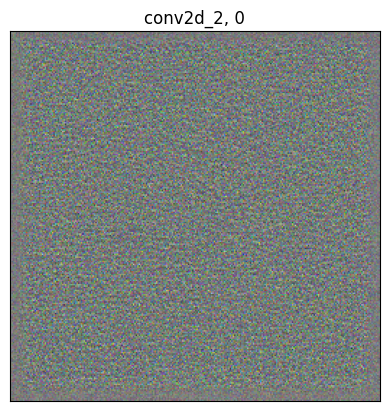

Iteration: 20, Loss: 2.0077


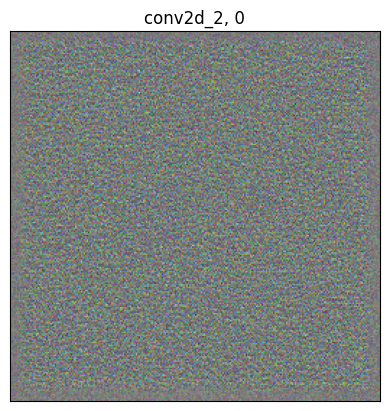

Iteration: 20, Loss: 2.0096


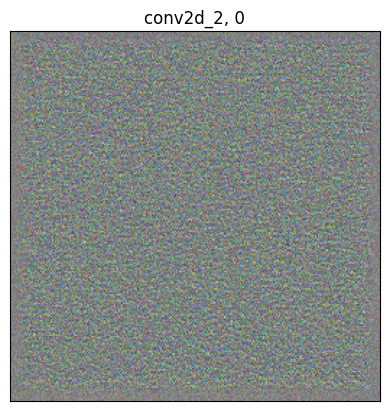

Iteration: 20, Loss: 2.0093


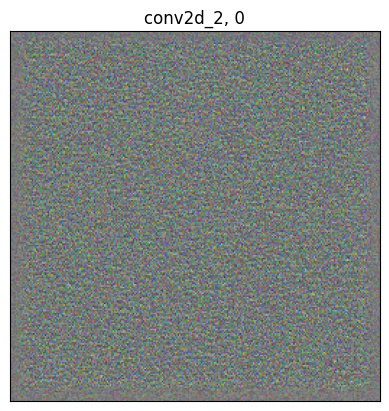

Iteration: 20, Loss: 2.0072


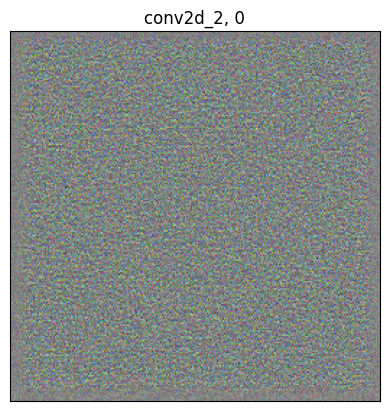

Iteration: 20, Loss: 2.0135


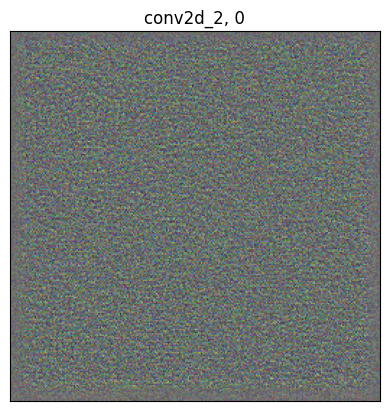

Iteration: 20, Loss: 2.0089


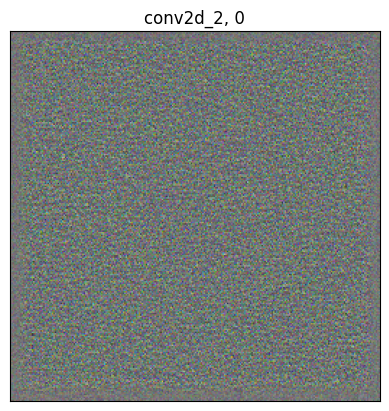

Iteration: 20, Loss: 2.0052


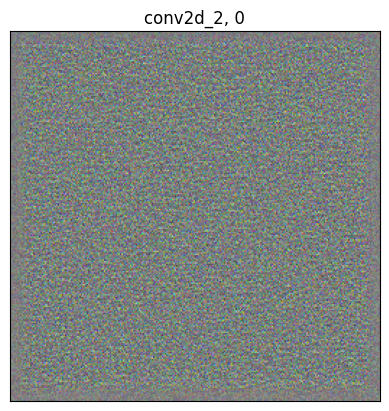

Iteration: 20, Loss: 2.0097


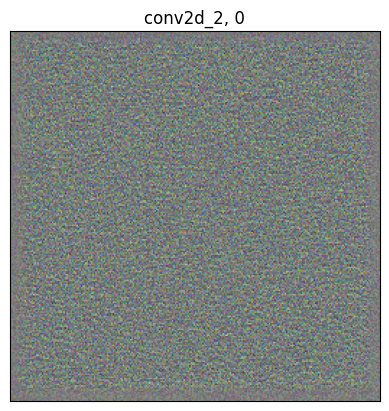

Iteration: 20, Loss: 2.0057


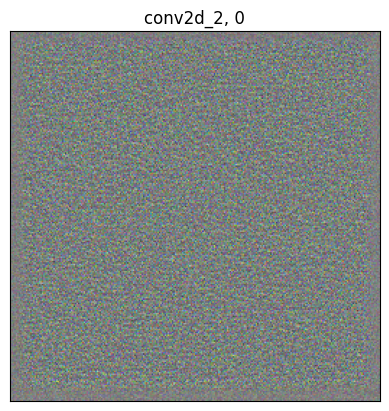

Iteration: 20, Loss: 2.0061


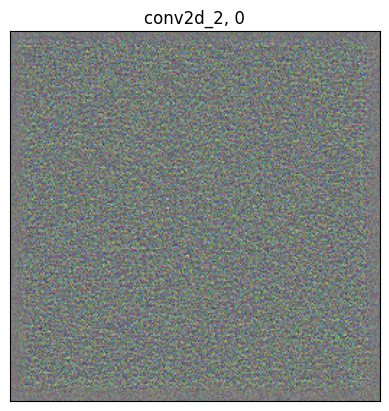

Iteration: 20, Loss: 2.0108


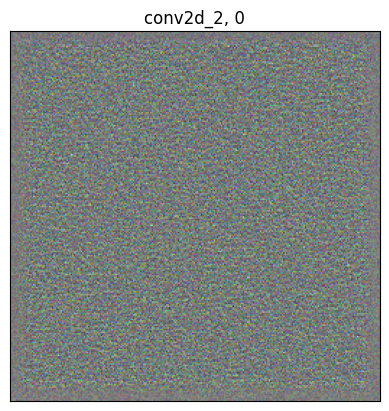

Iteration: 20, Loss: 2.0107


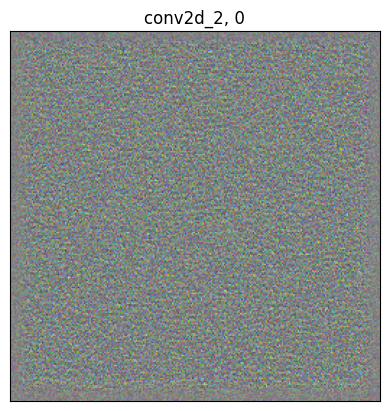

Iteration: 20, Loss: 2.0020


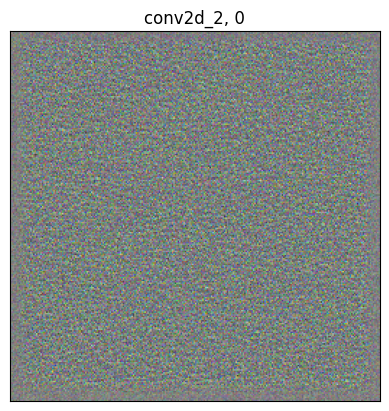

Iteration: 20, Loss: 2.0058


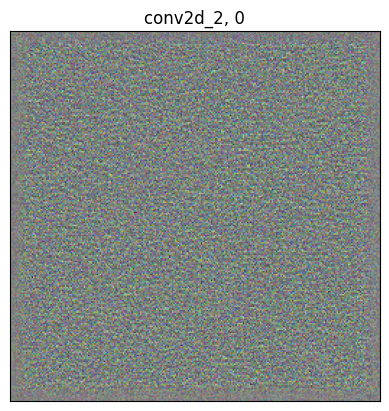

Iteration: 20, Loss: 2.0087


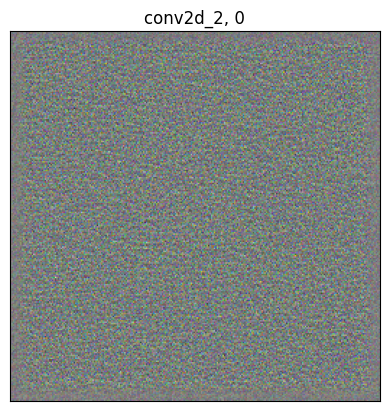

Iteration: 20, Loss: 2.0076


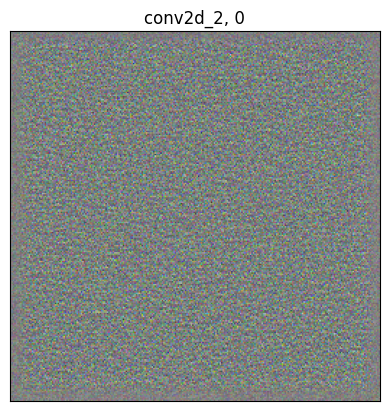

Iteration: 20, Loss: 2.0109


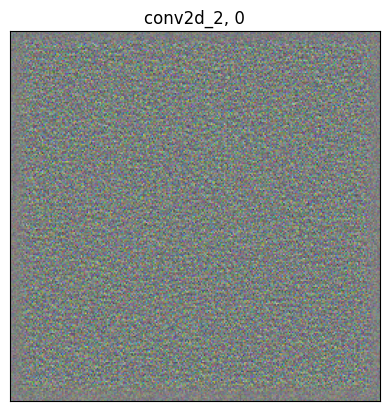

Iteration: 20, Loss: 2.0143


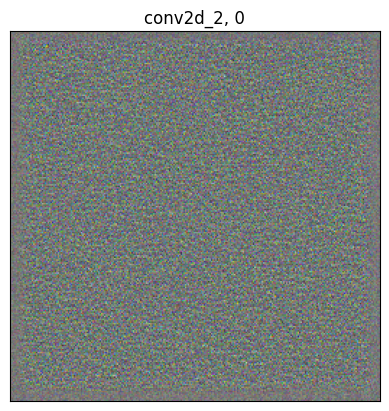

Iteration: 20, Loss: 2.0120


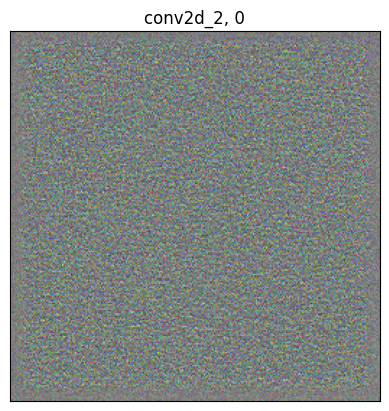

Iteration: 20, Loss: 2.0049


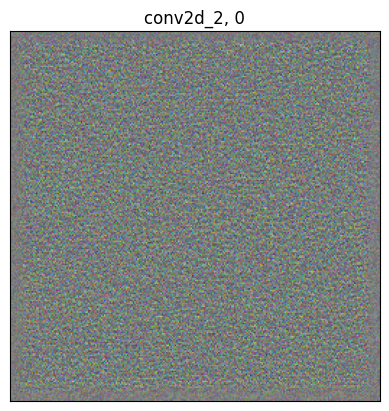

Iteration: 20, Loss: 2.0122


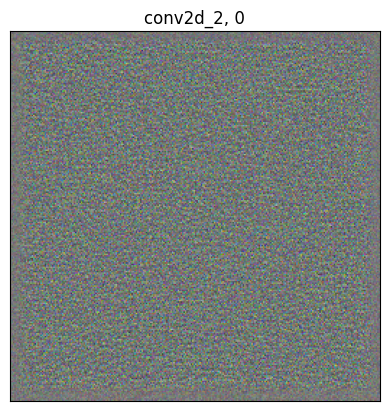

Iteration: 20, Loss: 2.0039


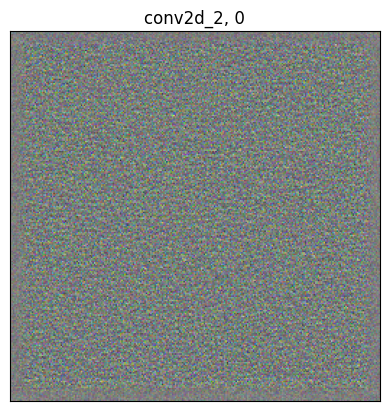

Iteration: 20, Loss: 2.0088


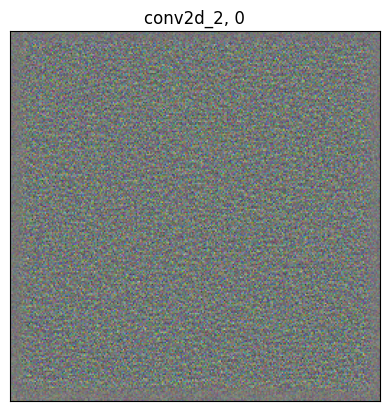

Iteration: 20, Loss: 2.0072


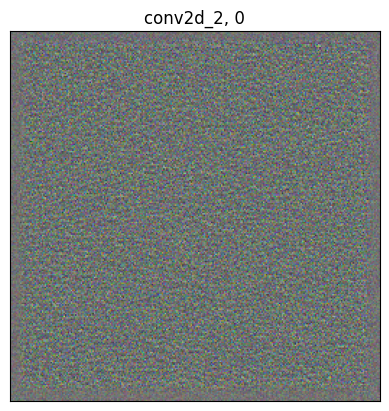

Iteration: 20, Loss: 2.0031


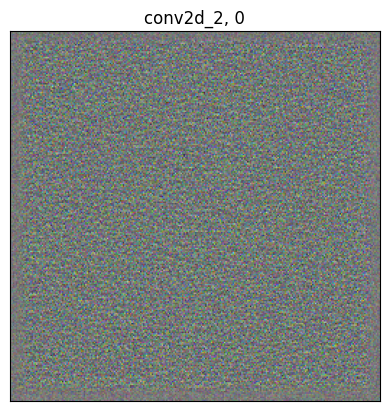

Iteration: 20, Loss: 2.0124


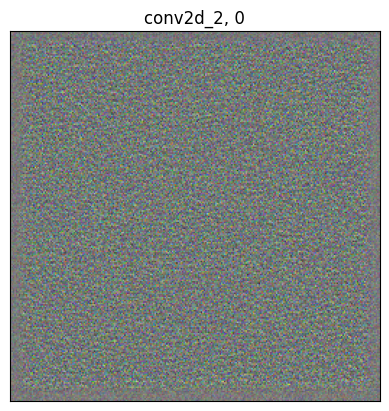

Iteration: 20, Loss: 2.0067


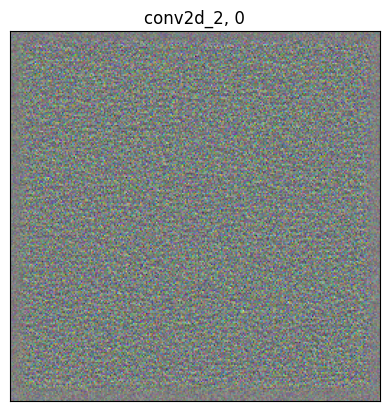

Iteration: 20, Loss: 2.0150


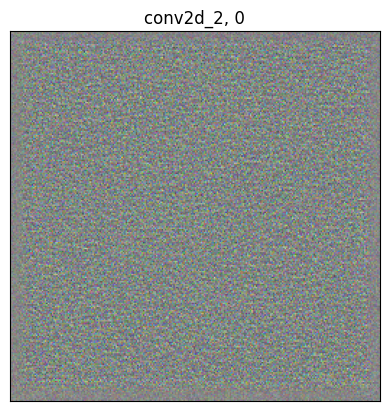

Iteration: 20, Loss: 2.0019


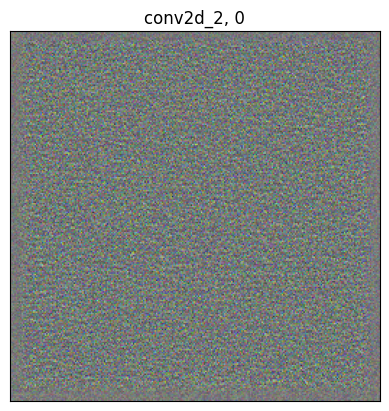

Iteration: 20, Loss: 2.0067


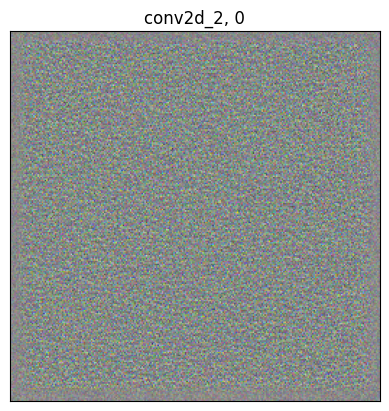

Iteration: 20, Loss: 2.0075


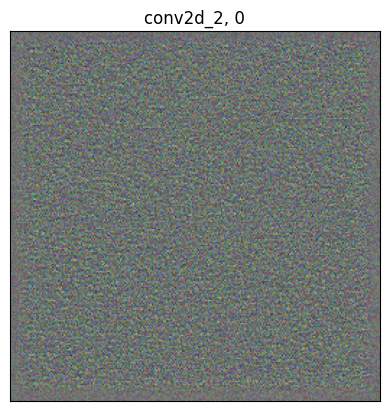

Iteration: 20, Loss: 2.0005


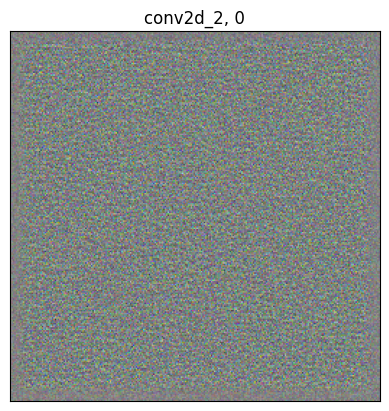

Iteration: 20, Loss: 2.0085


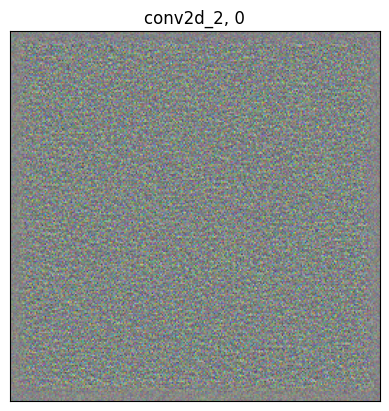

Iteration: 20, Loss: 2.0041


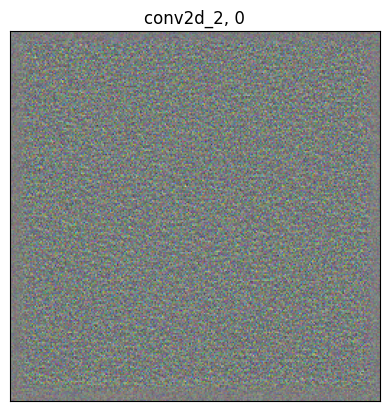

Iteration: 20, Loss: 2.0113


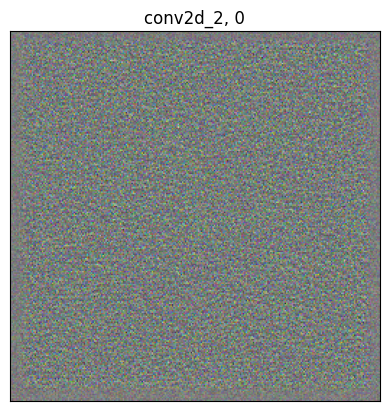

Iteration: 20, Loss: 2.0097


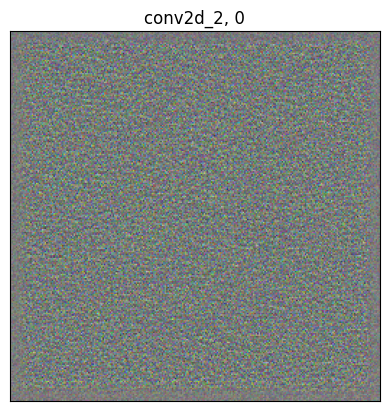

Iteration: 20, Loss: 2.0109


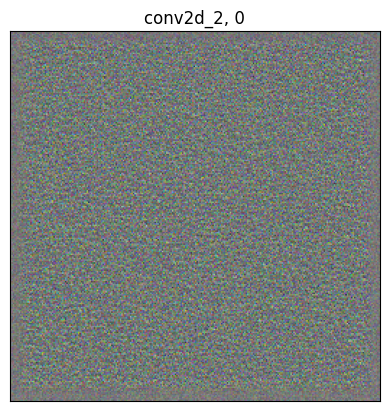

Iteration: 20, Loss: 2.0107


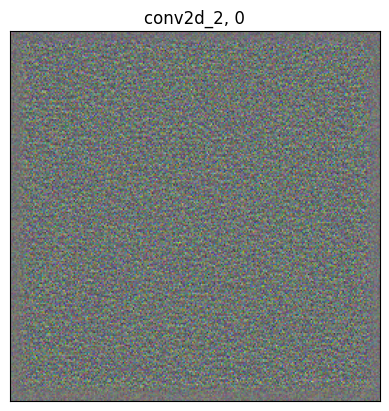

Iteration: 20, Loss: 2.0002


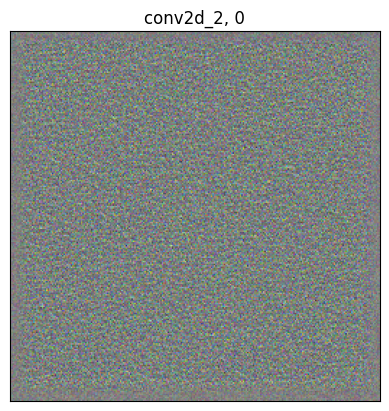

Iteration: 20, Loss: 2.0059


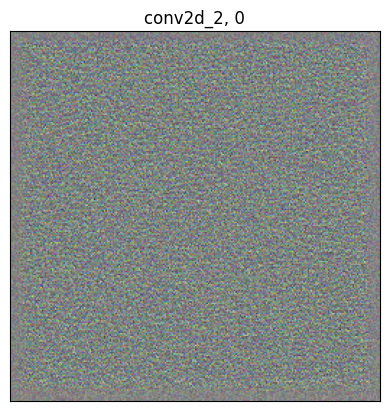

Iteration: 20, Loss: 2.0148


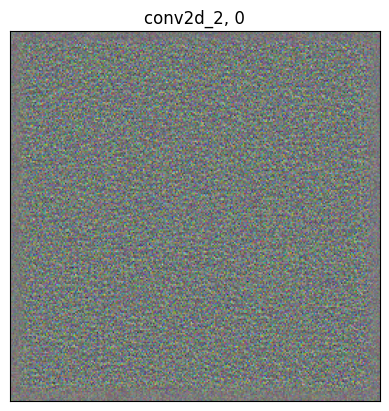

Iteration: 20, Loss: 2.0071


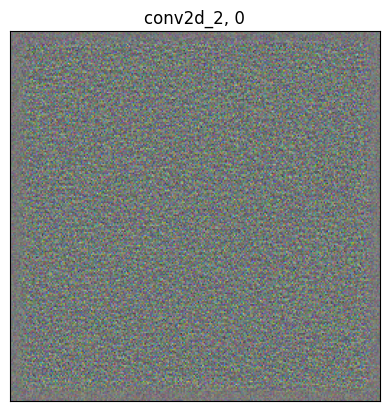

Iteration: 20, Loss: 2.0027


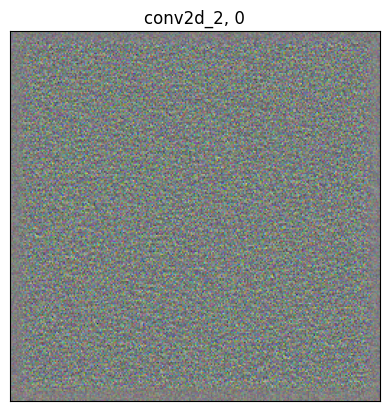

Iteration: 20, Loss: 2.0098


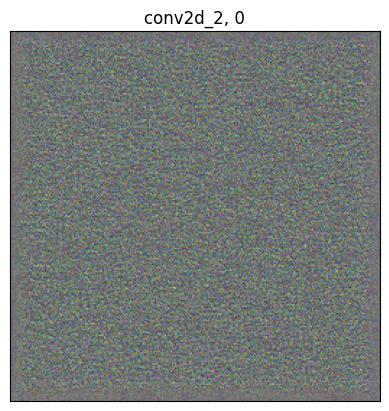

Iteration: 20, Loss: 2.0106


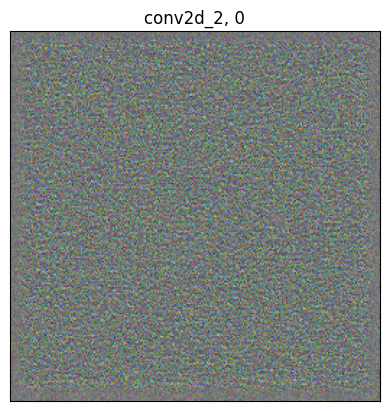

Iteration: 20, Loss: 2.0126


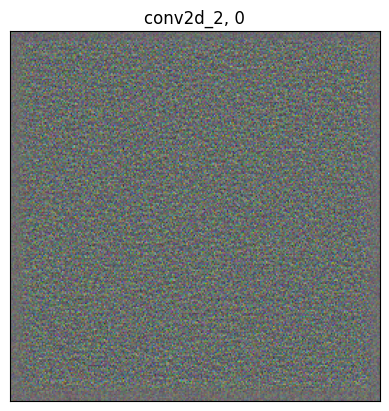

Iteration: 20, Loss: 2.0071


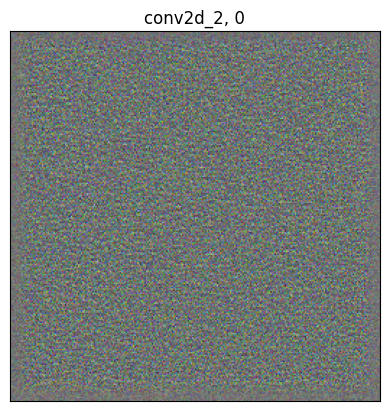

Iteration: 20, Loss: 2.0142


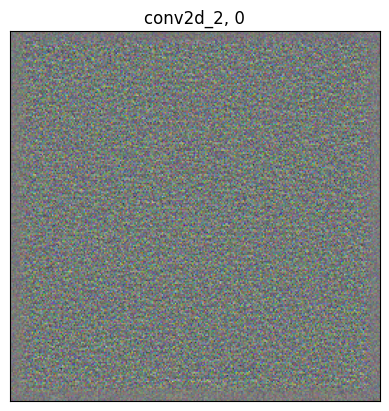

Iteration: 20, Loss: 2.0090


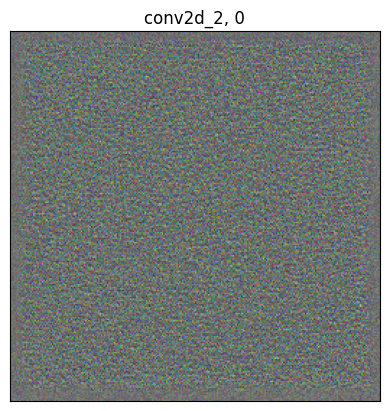

Iteration: 20, Loss: 2.0067


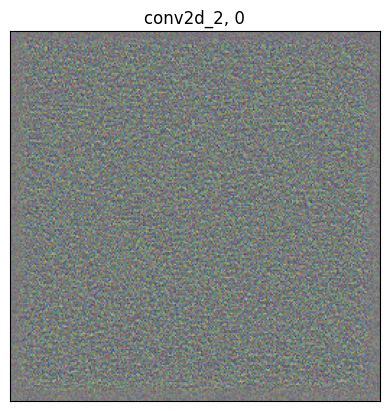

Iteration: 20, Loss: 2.0137


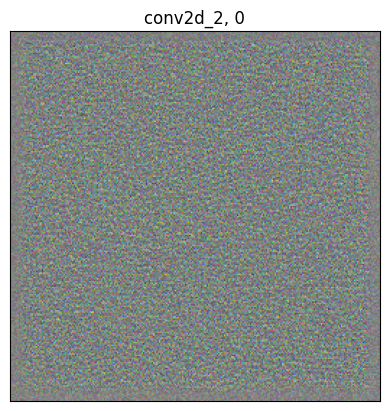

Iteration: 20, Loss: 2.0111


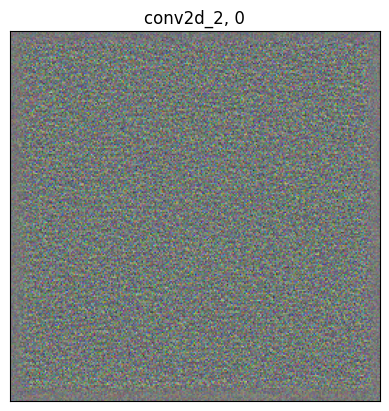

Iteration: 20, Loss: 2.0040


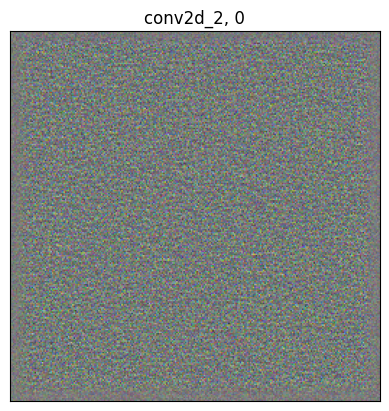

Iteration: 20, Loss: 2.0059


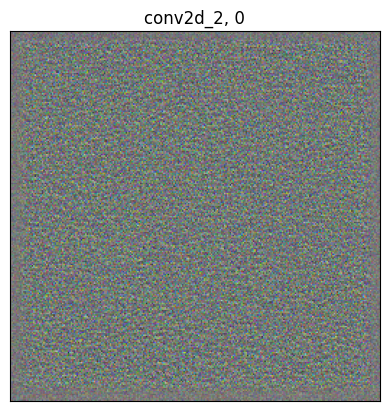

Iteration: 20, Loss: 2.0155


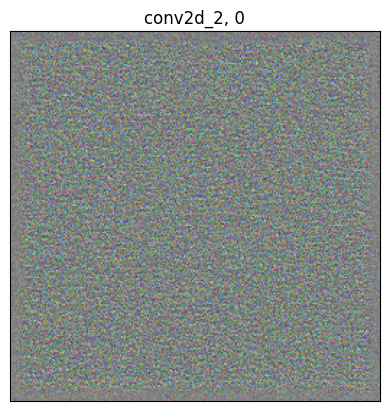

Iteration: 20, Loss: 2.0075


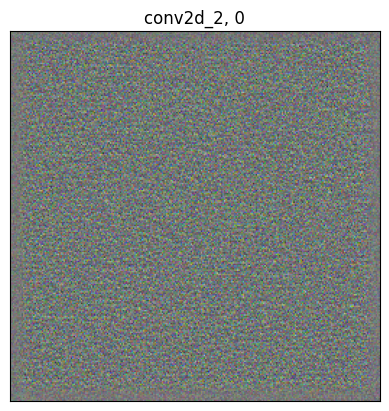

Iteration: 20, Loss: 2.0073


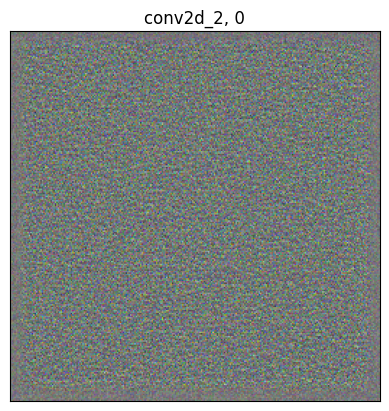

Iteration: 20, Loss: 2.0074


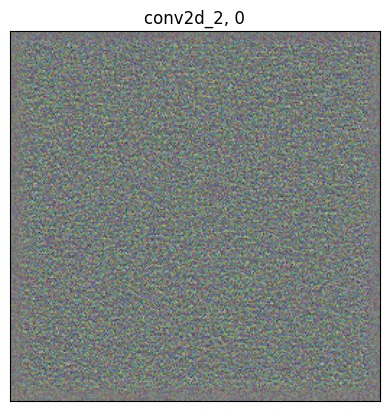

Iteration: 20, Loss: 2.0068


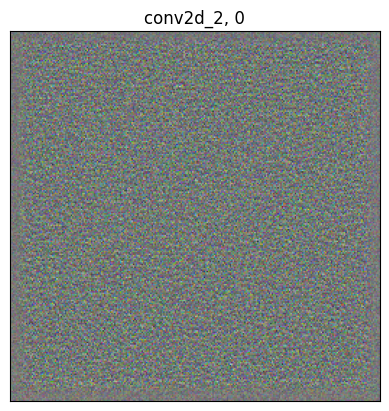

Iteration: 20, Loss: 2.0057


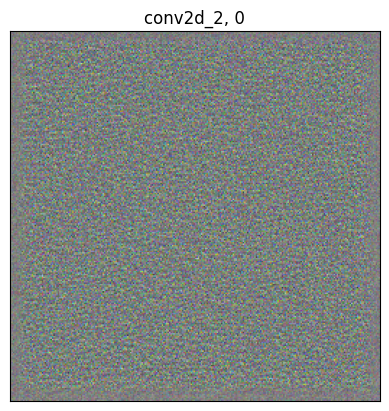

Iteration: 20, Loss: 2.0133


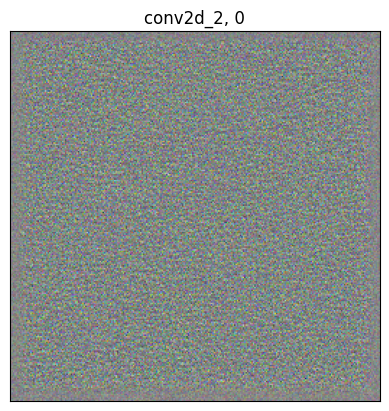

Iteration: 20, Loss: 2.0046


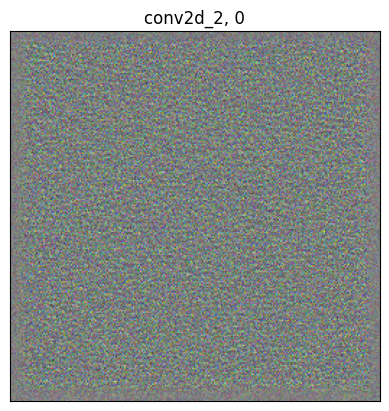

Iteration: 20, Loss: 2.0065


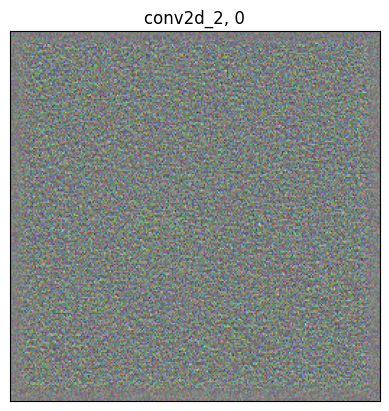

Iteration: 20, Loss: 2.0050


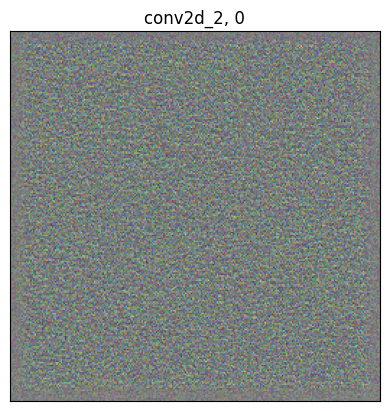

Iteration: 20, Loss: 2.0096


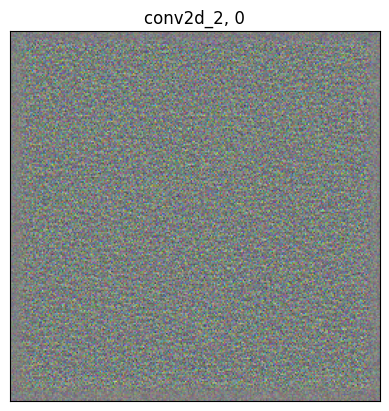

Iteration: 20, Loss: 2.0018


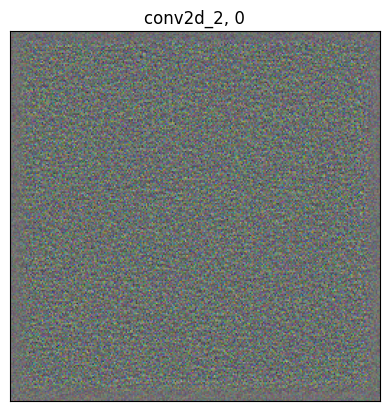

KeyboardInterrupt: 

In [32]:
for i in indices:
    visualise_filters(model = model, layer_name = model.layers[-5].name , f_index = i)